In [1]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import pywt
import numpy as np

from wvt_basis_manager_3d import WaveletBasisManager3d

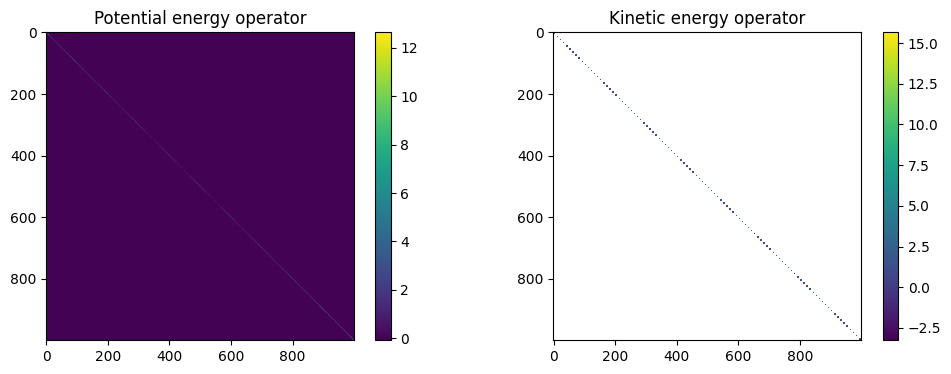

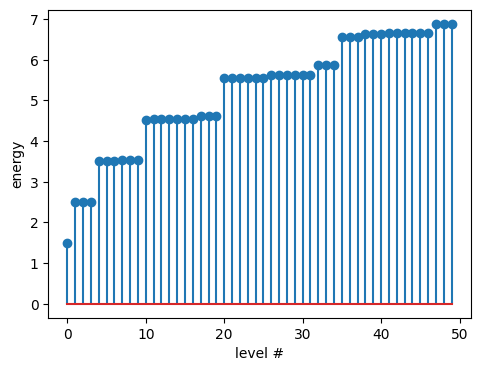

In [2]:
def experiment(
    wvt_name="sym8",
    lims_x=(-7, 7),
    lims_y=(-7, 7),
    lims_z=(-7, 7),
    nsteps_x=10,
    nsteps_y=10,
    nsteps_z=10,
    do_plots=True,
    plot_levels=50,
):
    results = {}
    wvt = pywt.Wavelet(wvt_name)
    wvt_man = WaveletBasisManager3d(
        wvt,
        (nsteps_x, nsteps_y, nsteps_z),
        lims_x,
        lims_y,
        lims_z,
    )
    potential_func = lambda xx, yy, zz: (xx**2 + yy**2 + zz**2) / 2
    total_steps = nsteps_x * nsteps_y * nsteps_z
    V_mat = wvt_man.get_matrix_elements(potential_func).reshape(total_steps, total_steps)
    T_mat = wvt_man.get_ke_matrix().reshape(total_steps, total_steps)

    if do_plots:
        plt.figure(figsize=(12, 4))
        plt.subplot(1, 2, 1)
        plt.imshow(np.ma.masked_array(V_mat, V_mat == 0))
        plt.colorbar()
        plt.title("Potential energy operator")
        plt.subplot(1, 2, 2)
        plt.imshow(np.ma.masked_array(T_mat, T_mat == 0))
        plt.colorbar()
        plt.title("Kinetic energy operator")

    H_mat = V_mat + T_mat
    energies, states = np.linalg.eigh(H_mat)
    eigh_error = np.abs(H_mat @ states - states * energies[None, :]).max()
    if eigh_error > 1e-8:
        print("Warning: eigh error =", eigh_error)

    if do_plots:
        plt.figure(figsize=(12, 4))
        plt.subplot(1, 2, 1)
        plt.stem(energies[:plot_levels]);
        plt.xlabel("level #")
        plt.ylabel("energy")

    results["V"] = V_mat
    results["T"] = T_mat
    results['man'] = wvt_man
    results["energies"], results["states"] = energies, states

    return results

results_10x10x10 = experiment()

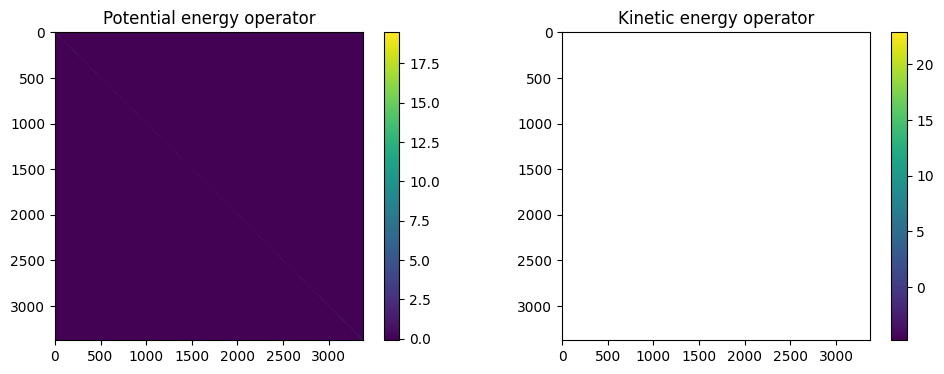

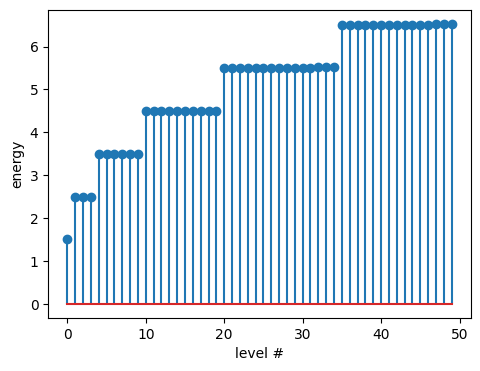

In [3]:
results_15x15x15 = experiment(nsteps_x=15, nsteps_y=15, nsteps_z=15)

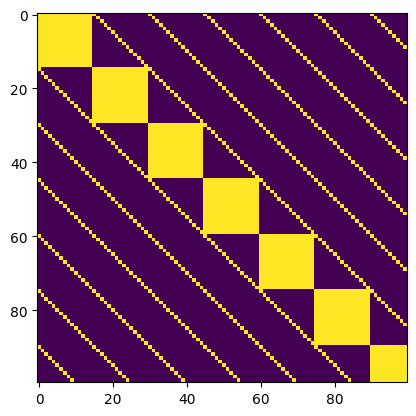

In [9]:
plt.imshow(results_15x15x15["T"][:100, :100] != 0)

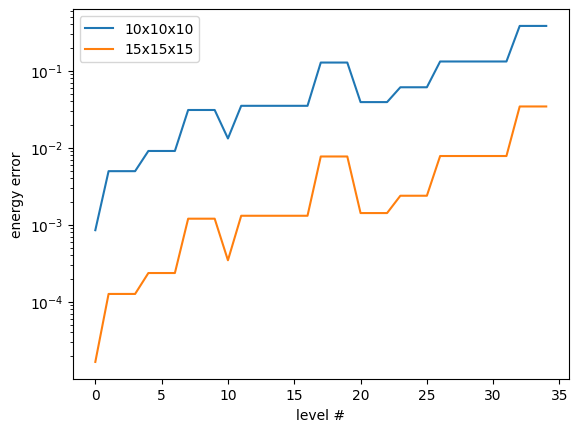

In [5]:
energies_gt = np.array([1.5] + 3 * [2.5] + 6 * [3.5] + 10 * [4.5] + 15 * [5.5])
plt.plot(results_10x10x10['energies'][:len(energies_gt)] - energies_gt, label="10x10x10")
plt.plot(results_15x15x15['energies'][:len(energies_gt)] - energies_gt, label="15x15x15")
plt.xlabel("level #")
plt.ylabel("energy error")
plt.yscale("log")
plt.legend();

In [10]:
import plotly.graph_objects as go

In [11]:
def plot_state(results, i=0, lims=3):
    xx, yy, zz, ff = results["man"].reconstruct(results["states"][:, i])
    xx, yy, zz = np.meshgrid(xx, yy, zz, indexing='ij')

    sel = (
        (xx > -lims) & (xx < lims)
        & (yy > -lims) & (yy < lims)
        & (zz > -lims) & (zz < lims)
    )
    xx = xx[sel]
    yy = yy[sel]
    zz = zz[sel]
    ff = ff[sel]

    ff = ff**2

    max_density = ff.max()

    fig = go.Figure(data=go.Isosurface(
        x=xx.ravel(),
        y=yy.ravel(),
        z=zz.ravel(),
        value=ff.ravel(),
        opacity=0.6,
        isomin=0.1 * ff.max(),
        isomax=ff.max(),
        surface_count=3,
    ))
    fig.show()

plot_state(results_10x10x10)

In [12]:
plot_state(results_10x10x10, i=1)

In [13]:
plot_state(results_10x10x10, i=4)